In [1]:
import os
import numpy as np
import pandas as pd
import scanpy as sc
import loompy as lp
import scipy.sparse as sp
from MulticoreTSNE import MulticoreTSNE as TSNE
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
wdir = "/Users/jakobmaeots/Internship/"
os.chdir( wdir )

loom_file = "Data/Velmeshev_2019_matrix.loom"

# Open the loom file with loompy
ds = lp.connect(loom_file)

# # path to loom file with basic filtering applied (this will be created in the "initial filtering" step below). Optional.
f_loom_path_scenic = "Data/NEN_I/NEN_I.loom"

# path to anndata object, which will be updated to store Scanpy results as they are generated below
f_anndata_path = "Data/NEN_I/NEN_I.h5ad"

# path to pyscenic output
f_pyscenic_output = "Data/NEN_I/NEN_I_SCENIC.loom"

# loom output, generated from a combination of Scanpy and pySCENIC results:
f_final_loom = 'Data/NEN_I/NEN_I_integrated-output.loom'

In [3]:
X = ds[:, :]

# Function to process attributes: try to squeeze to 1D; if not, skip the attribute
def process_attributes(attr_dict):
    new_attrs = {}
    for key in attr_dict.keys():
        try:
            arr = np.array(attr_dict[key])
            arr = np.squeeze(arr)
            if arr.ndim == 1:
                new_attrs[key] = arr
            else:
                print(f"Skipping attribute {key}: array is not 1D after squeezing (shape {arr.shape})")
        except Exception as e:
            print(f"Error processing attribute {key}: {e}")
    return new_attrs

In [4]:
# Process cell attributes (obs) and gene attributes (var)
obs_dict = process_attributes(ds.ca)
var_dict = process_attributes(ds.ra)

# Create DataFrames
obs = pd.DataFrame(obs_dict)
var = pd.DataFrame(var_dict)

# (Optional) If you expect specific keys (like "CellID" or "Gene") use them for index names.
# If these keys are missing or problematic, you can create simple indices.
if "CellID" in ds.ca.keys():
    obs.index = np.array(ds.ca["CellID"]).squeeze()
else:
    obs.index = [f"cell_{i}" for i in range(obs.shape[0])]

if "Gene" in ds.ra.keys():
    var.index = np.array(ds.ra["Gene"]).squeeze()
else:
    var.index = [f"gene_{i}" for i in range(var.shape[0])]

# Loom files are typically genes x cells.
# Scanpy’s AnnData expects the data matrix to be cells x genes.
# Also, if your matrix is large and sparse (which is common), convert it.
if not sp.issparse(X):
    print("Converting expression matrix to sparse CSR format")
    X = sp.csr_matrix(X)

Converting expression matrix to sparse CSR format


In [5]:
adata = sc.AnnData(X=X.T, obs=obs, var=var)
adata.var_names_make_unique()
# Close the loom file connection
ds.close()

# Verify the resulting AnnData object
print(adata)

/opt/anaconda3/envs/scenic_env_py310/lib/python3.10/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/opt/anaconda3/envs/scenic_env_py310/lib/python3.10/site-packages/anndata/utils.py:268: UserWarning: Suffix used (-[0-9]+) to deduplicate index values may make index values difficult to interpret. There values with a similar suffixes in the index. Consider using a different delimiter by passing `join={delimiter}`Example key collisions generated by the make_index_unique algorithm: ['SNORD116-1', 'SNORD116-2', 'SNORD116-3', 'SNORD116-4', 'SNORD116-5']
  warnings.warn(


AnnData object with n_obs × n_vars = 104559 × 65217
    obs: 'CT_ann_ABM_MCA_scmap_cell2cluster_51_CTs', 'CT_ann_score_ABM_MCA_scmap_cell2cluster_51_CTs', 'Capbatch', 'RNA Integrity Number', 'RNA mitochondr. percent', 'RNA ribosomal percent', 'Seqbatch', 'UMIs', 'age', 'batch', 'brain_region', 'cell', 'cell_id', 'cluster', 'condition', 'donor_id', 'genes', 'obs_names', 'post_mortem_interval', 'region', 'sample', 'sex', 'study_id'
    var: 'Gene', 'ensembl_id', 'gene_name', 'var_names'


In [6]:
unique_Vclusters = adata.obs['cluster'].unique()

# Print the unique study IDs
print("Unique Vclusters:", unique_Vclusters)

Unique Vclusters: ['Neu-NRGN-II' 'L5/6' 'Oligodendrocytes' 'OPC' 'AST-FB' 'Endothelial'
 'Microglia' 'Neu-NRGN-I' 'IN-VIP' 'L5/6-CC' 'IN-SV2C' 'L2/3' 'IN-PV' 'L4'
 'IN-SST' 'Neu-mat' 'AST-PP']


In [7]:
unique_samples = adata.obs['sample'].unique()

# Print the unique study IDs
print("samples:", unique_samples)

samples: ['1823_BA24' '4341_BA24' '4341_BA46' '4849_BA24' '4899_BA24' '5144_PFC'
 '5163_BA24' '5242_BA24' '5278_BA24' '5278_PFC' '5294_BA24' '5294_BA9'
 '5387_BA9' '5391_BA24' '5403_PFC' '5408_PFC_Nova' '5419_PFC' '5531_BA24'
 '5531_BA9' '5538_PFC_Nova' '5554_BA24' '5565_BA24' '5565_BA9' '5577_BA9'
 '5841_BA9' '5864_BA9' '5879_PFC_Nova' '5893_BA24' '5893_PFC'
 '5936_PFC_Nova' '5939_BA24' '5939_BA9' '5945_PFC' '5958_BA24' '5958_BA9'
 '5976_BA9' '5978_BA24' '5978_BA9' '6032_BA24' '6033_BA24' '6033_BA9']


In [8]:
sc.settings.verbosity = 3 # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.set_figure_params(dpi=150, fontsize=10, dpi_save=600)

/var/folders/3n/bg3b1qfs4jz9hnh_q29xp5k00000gn/T/ipykernel_23121/1167869884.py:2: FutureWarning: Use `print_header` instead
  sc.logging.print_versions()


In [9]:
# Set maximum number of jobs for Scanpy.
sc.settings.njobs = 20

In [10]:
nCountsPerGene = np.sum(adata.X, axis=0)
nCellsPerGene = np.sum(adata.X>0, axis=0)

# Show info
print("Number of counts (in the dataset units) per gene:", nCountsPerGene.min(), " - " ,nCountsPerGene.max())
print("Number of cells in which each gene is detected:", nCellsPerGene.min(), " - " ,nCellsPerGene.max())

Number of counts (in the dataset units) per gene: 0.0  -  32212542.0
Number of cells in which each gene is detected: 0  -  104067


In [11]:
nCells=adata.X.shape[0]

# pySCENIC thresholds
minCountsPerGene=3*.01*nCells # 3 counts in 1% of cells
print("minCountsPerGene: ", minCountsPerGene)

minSamples=.01*nCells # 1% of cells
print("minSamples: ", minSamples)

minCountsPerGene:  3136.77
minSamples:  1045.59


In [12]:
# Define the cell types you want to keep as a list
NEN_I_id = [
    'Neu-NRGN-I'
]

# Filter the dataset
adata = adata[adata.obs['cluster'].isin(NEN_I_id)]

# Verify the filtering
print(f"Number of cells after filtering: {adata.n_obs}")
print(f"Unique samples after filtering: {adata.obs['cluster'].unique()}")

Number of cells after filtering: 3543
Unique samples after filtering: ['Neu-NRGN-I']


In [13]:
# Simply compute the number of genes per cell
sc.pp.filter_cells(adata, min_genes=0)

# Identify mitochondrial genes, assuming gene names starting with 'MT-'
mito_genes = adata.var_names.str.startswith('MT-')

# Compute the sum of counts in mitochondrial genes for each cell
mito_sum = np.array(adata[:, mito_genes].X.sum(axis=1)).flatten()

# Compute the total counts per cell
total_sum = np.array(adata.X.sum(axis=1)).flatten()

# Compute percent mitochondrial and add total counts to adata.obs
adata.obs['percent_mito'] = mito_sum / total_sum
adata.obs['n_counts'] = total_sum

/opt/anaconda3/envs/scenic_env_py310/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:170: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["n_genes"] = number


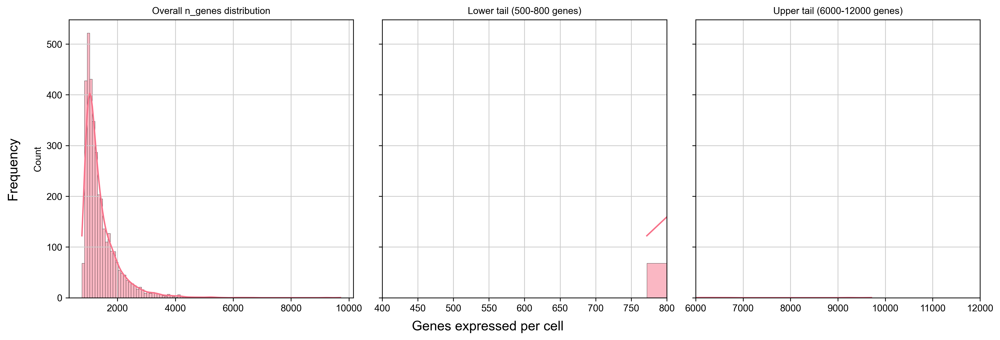

In [14]:
# Set the color palette
sns.set_palette("husl")

# Use the n_genes column from your AnnData object
x = adata.obs['n_genes']

# Define the number of bins for the histogram
nbins = 100

# Create subplots: overall distribution, lower tail, and upper tail
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5), dpi=150, sharey=True)

# Overall n_genes distribution
sns.histplot(x, ax=ax1, bins=nbins, kde=True)
ax1.set_title('Overall n_genes distribution')

# Lower tail: limit x-axis from 500 to 800
sns.histplot(x, ax=ax2, bins=nbins, kde=True)
ax2.set_xlim(400, 800)
ax2.set_title('Lower tail (500-800 genes)')

# Upper tail: limit x-axis from 6000 to 12000
sns.histplot(x, ax=ax3, bins=nbins, kde=True)
ax3.set_xlim(6000, 12000)
ax3.set_title('Upper tail (6000-12000 genes)')

# Remove individual x-axis labels (use global x-label instead)
for ax in (ax1, ax2, ax3):
    ax.set_xlabel('')

# Add a common y-axis label for Frequency
fig.text(0.04, 0.5, 'Frequency', ha='center', va='center', rotation='vertical', fontsize=14)

# Add a common x-axis label for Genes expressed per cell
fig.text(0.5, 0.04, 'Genes expressed per cell', ha='center', va='center', fontsize=14)

# Adjust layout to minimize overlap
fig.tight_layout(rect=[0.05, 0.05, 1, 1])

plt.show()

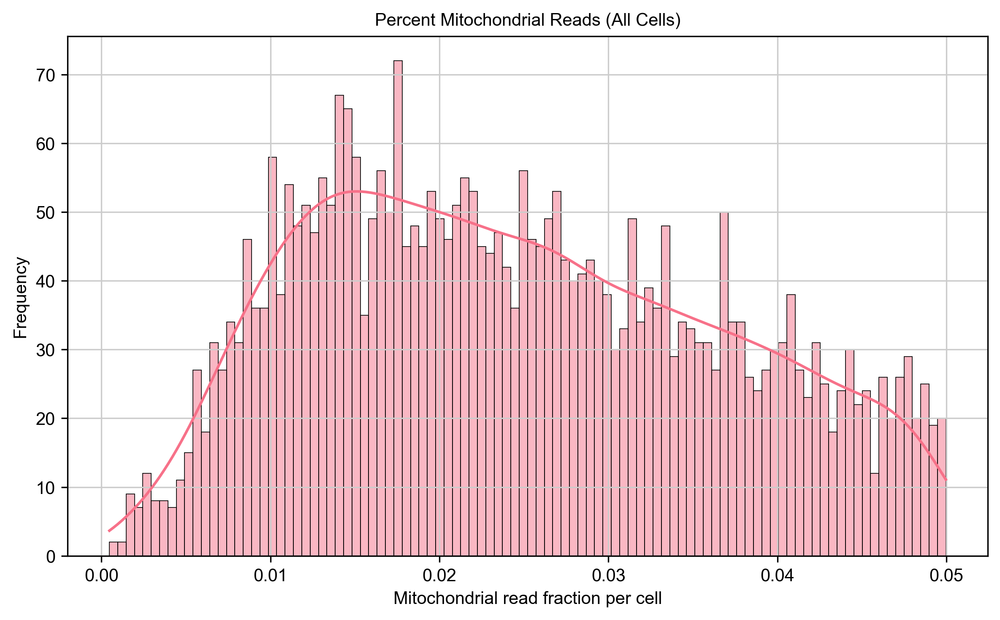

In [15]:
# Set the color palette (optional)
sns.set_palette("husl")

# Extract your data
x = adata.obs['percent_mito']
nbins = 100

# Create a single plot
fig, ax = plt.subplots(figsize=(8, 5), dpi=150)
sns.histplot(x, ax=ax, bins=nbins, kde=True)
ax.set_title("Percent Mitochondrial Reads (All Cells)")
ax.set_xlabel("Mitochondrial read fraction per cell")
ax.set_ylabel("Frequency")

plt.tight_layout()
plt.show()

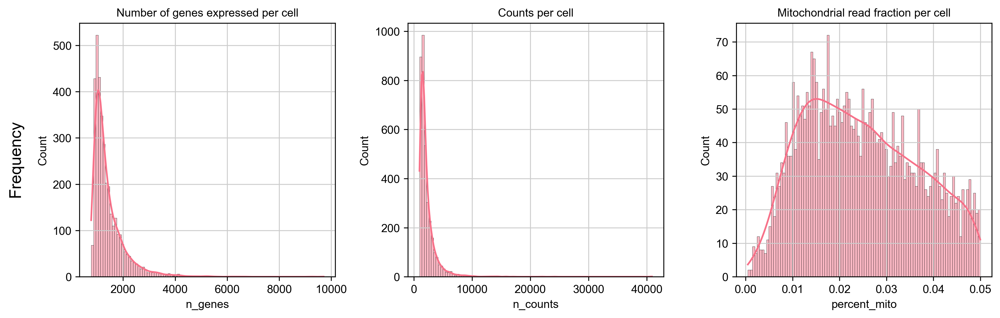

In [16]:
# Create subplots
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 4), dpi=150, sharey=False)

# Plot histograms with kernel density estimates
sns.histplot(adata.obs['n_genes'], ax=ax1, bins=100, kde=True)
sns.histplot(adata.obs['n_counts'], ax=ax2, bins=100, kde=True)
sns.histplot(adata.obs['percent_mito'], ax=ax3, bins=100, kde=True)

# Set titles
ax1.set_title('Number of genes expressed per cell')
ax2.set_title('Counts per cell')
ax3.set_title('Mitochondrial read fraction per cell')

# Set y-axis label
fig.text(-0.01, 0.5, 'Frequency', ha='center', va='center', rotation='vertical', size='x-large')

# Adjust layout
fig.tight_layout()

# Save the figure
fig.savefig('Results/Velmeshev/filtering_panel_prefilter_NEN_I.png', dpi=300, bbox_inches='tight')

/opt/anaconda3/envs/scenic_env_py310/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:921: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  g: sns.axisgrid.FacetGrid = sns.catplot(


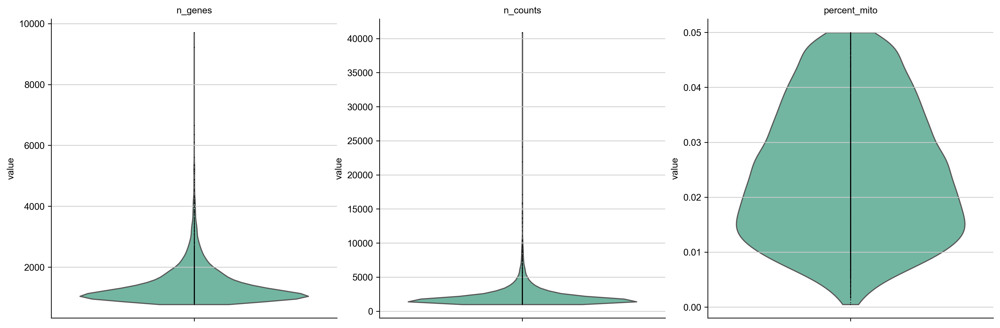

In [17]:
sc.pl.violin(adata, ['n_genes', 'n_counts', 'percent_mito'],
    jitter=0, multi_panel=True, palette="Set2")

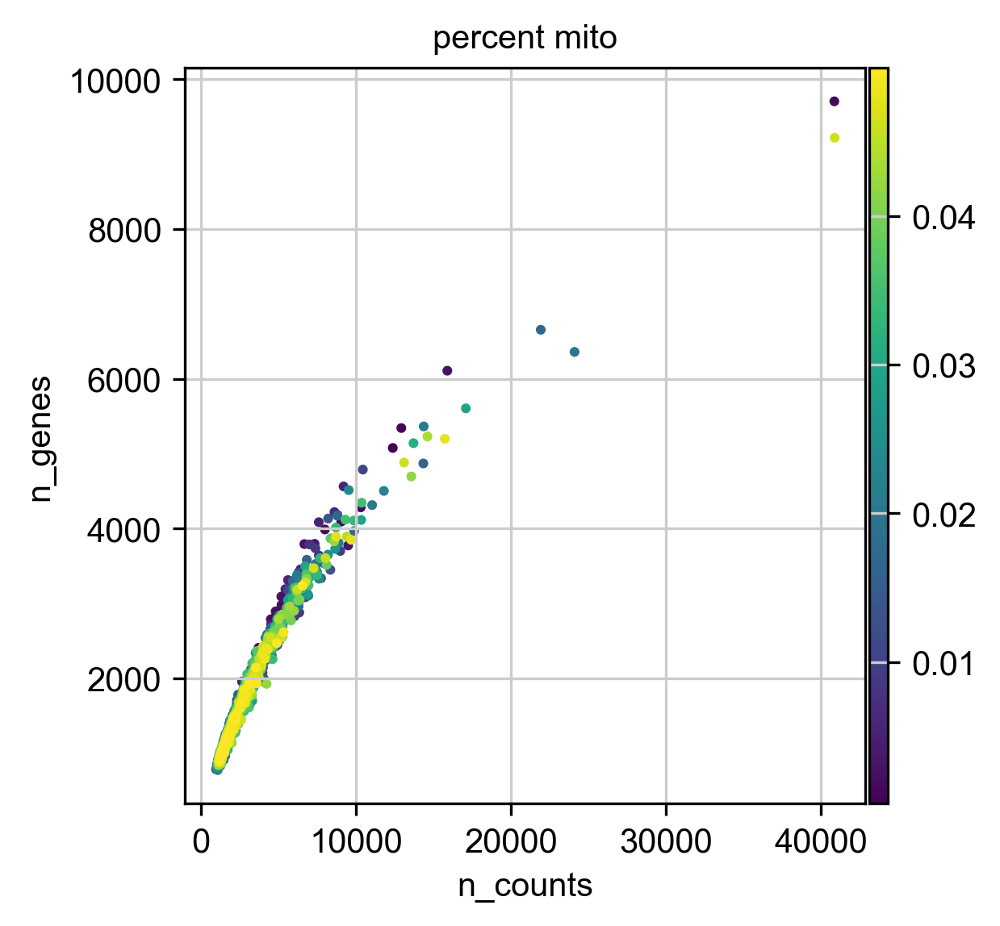

In [18]:
sc.pl.scatter(adata, x='n_counts', y='n_genes', color='percent_mito')

In [19]:
sc.pp.filter_cells(adata, min_genes=500 )
sc.pp.filter_genes(adata, min_cells=3 )

filtered out 43548 genes that are detected in less than 3 cells


In [20]:
adata = adata[adata.obs['n_genes'] < 8000, :]

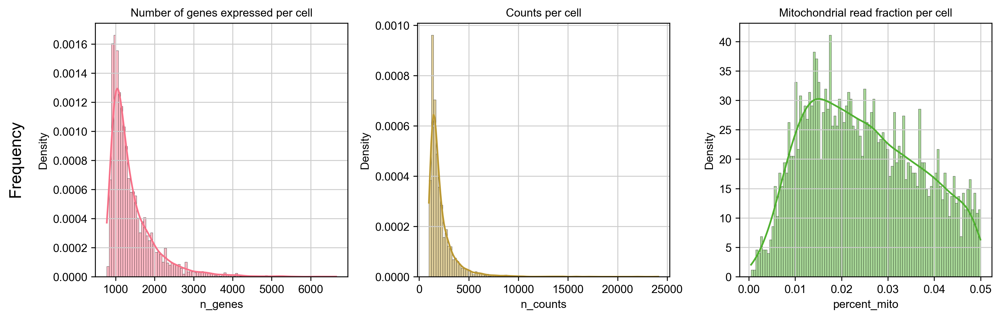

In [21]:
# Create subplots
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 4), dpi=150, sharey=False)

# Plot histograms with kernel density estimates
sns.histplot(adata.obs['n_genes'], ax=ax1, bins=100, kde=True, color=sns.color_palette("husl")[0], stat="density")
sns.histplot(adata.obs['n_counts'], ax=ax2, bins=100, kde=True, color=sns.color_palette("husl")[1], stat="density")
sns.histplot(adata.obs['percent_mito'], ax=ax3, bins=100, kde=True, color=sns.color_palette("husl")[2], stat="density")

# Set titles
ax1.set_title('Number of genes expressed per cell')
ax2.set_title('Counts per cell')
ax3.set_title('Mitochondrial read fraction per cell')

# Set y-axis label
fig.text(-0.01, 0.5, 'Frequency', ha='center', va='center', rotation='vertical', size='x-large')

# Adjust layout
fig.tight_layout()

# Save the figure
fig.savefig('Results/Velmeshev/filtering_panel_postfilter_NEN_I.png', dpi=300, bbox_inches='tight')

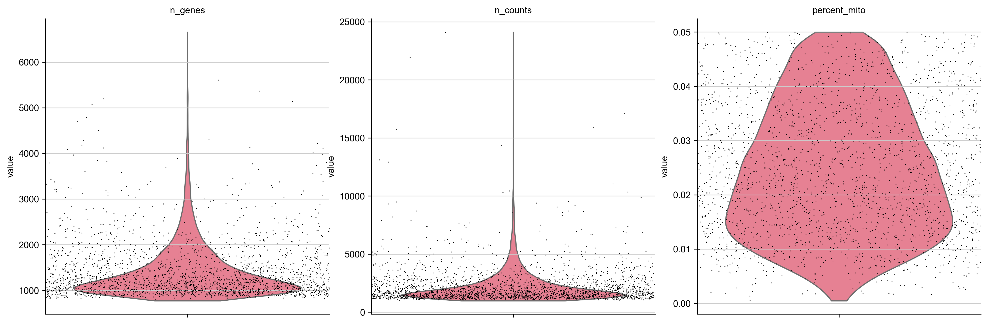

In [22]:
sc.pl.violin(adata, ['n_genes', 'n_counts', 'percent_mito'],
    jitter=0.8, multi_panel=True )

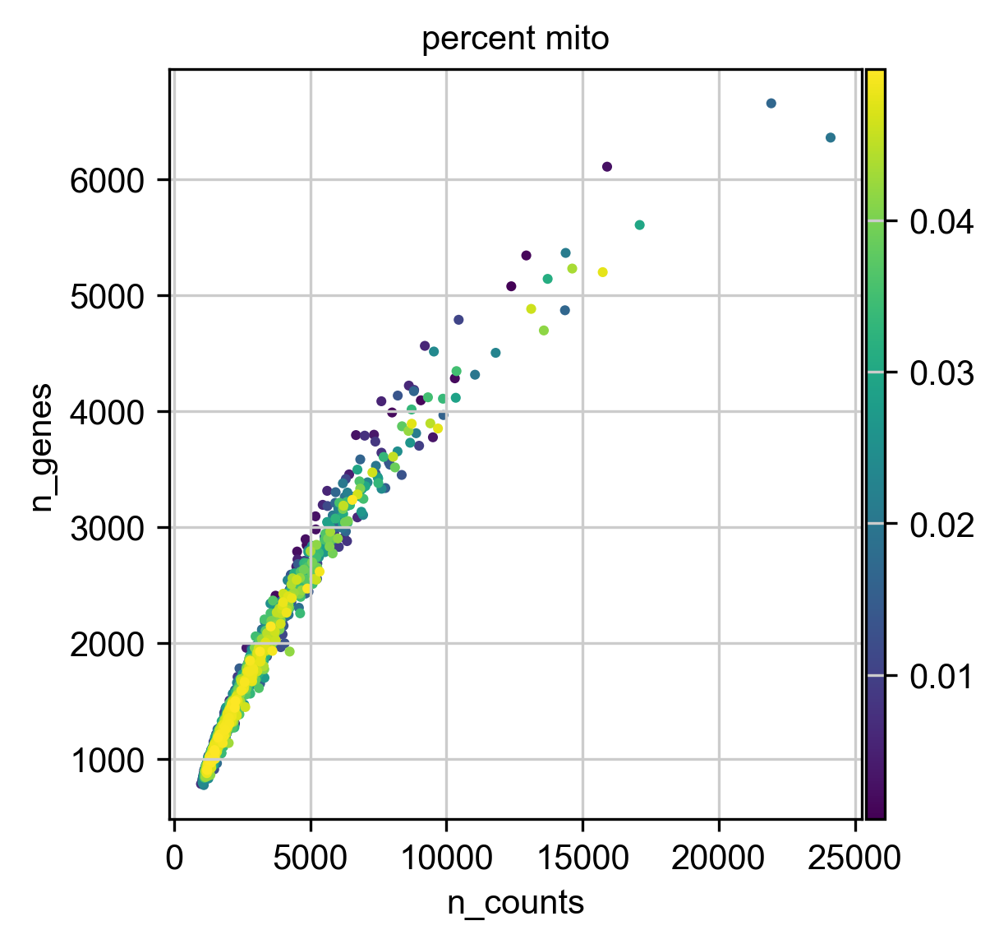

In [23]:
sc.pl.scatter(adata, x='n_counts', y='n_genes', color='percent_mito')

In [24]:
adata.write( f_anndata_path )

In [25]:
# create basic row and column attributes for the loom file:
row_attrs = {
    "Gene": np.array(adata.var_names) ,
}
col_attrs = {
    "CellID": np.array(adata.obs_names) ,
    "nGene": np.array( np.sum(adata.X.transpose()>0 , axis=0)).flatten() ,
    "nUMI": np.array( np.sum(adata.X.transpose() , axis=0)).flatten() ,
}
lp.create( f_loom_path_scenic, adata.X.transpose(), row_attrs, col_attrs)

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added
    'n_counts', counts per cell before normalization (adata.obs)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/var/folders/3n/bg3b1qfs4jz9hnh_q29xp5k00000gn/T/ipykernel_23121/3186822170.py:5: FutureWarning: Use sc.pp.normalize_total instead
  sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
/opt/anaconda3/envs/scenic_env_py310/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:589: FutureWarning: Use sc.pp.normalize_total instead
  normalize_per_cell(


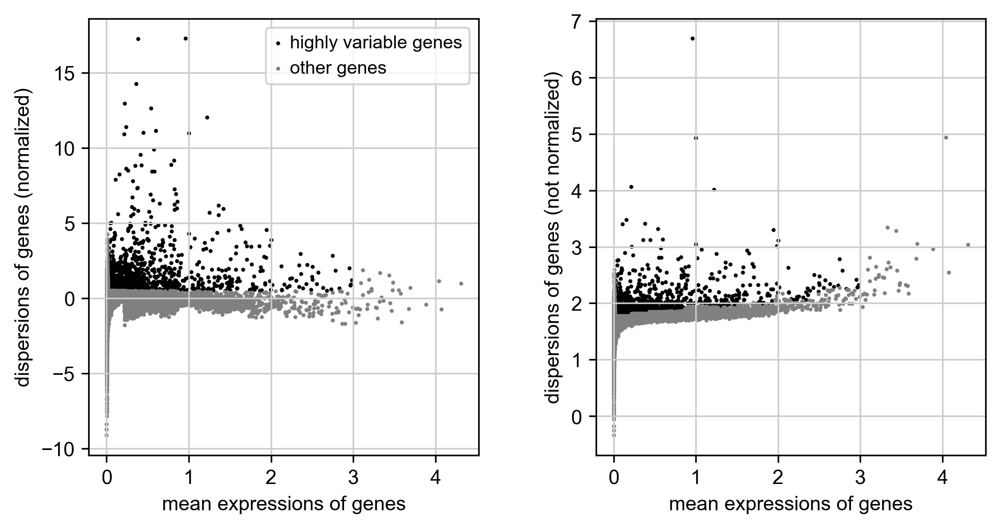

regressing out ['n_counts', 'percent_mito']
    sparse input is densified and may lead to high memory use
    finished (0:00:00)


/opt/anaconda3/envs/scenic_env_py310/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:710: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [26]:
# save a copy of the raw data
adata.raw = adata

# Total-count normalize (library-size correct) to 10,000 reads/cell
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)

# log transform the data.
sc.pp.log1p(adata)

# identify highly variable genes.
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata)

# keep only highly variable genes:
adata = adata[:, adata.var['highly_variable']]

# regress out total counts per cell and the percentage of mitochondrial genes expressed
sc.pp.regress_out(adata, ['n_counts', 'percent_mito'] ) #, n_jobs=args.threads)

# scale each gene to unit variance, clip values exceeding SD 10.
sc.pp.scale(adata, max_value=10)

# update the anndata file:
adata.write( f_anndata_path )

computing PCA
    with n_comps=50
    finished (0:00:01)


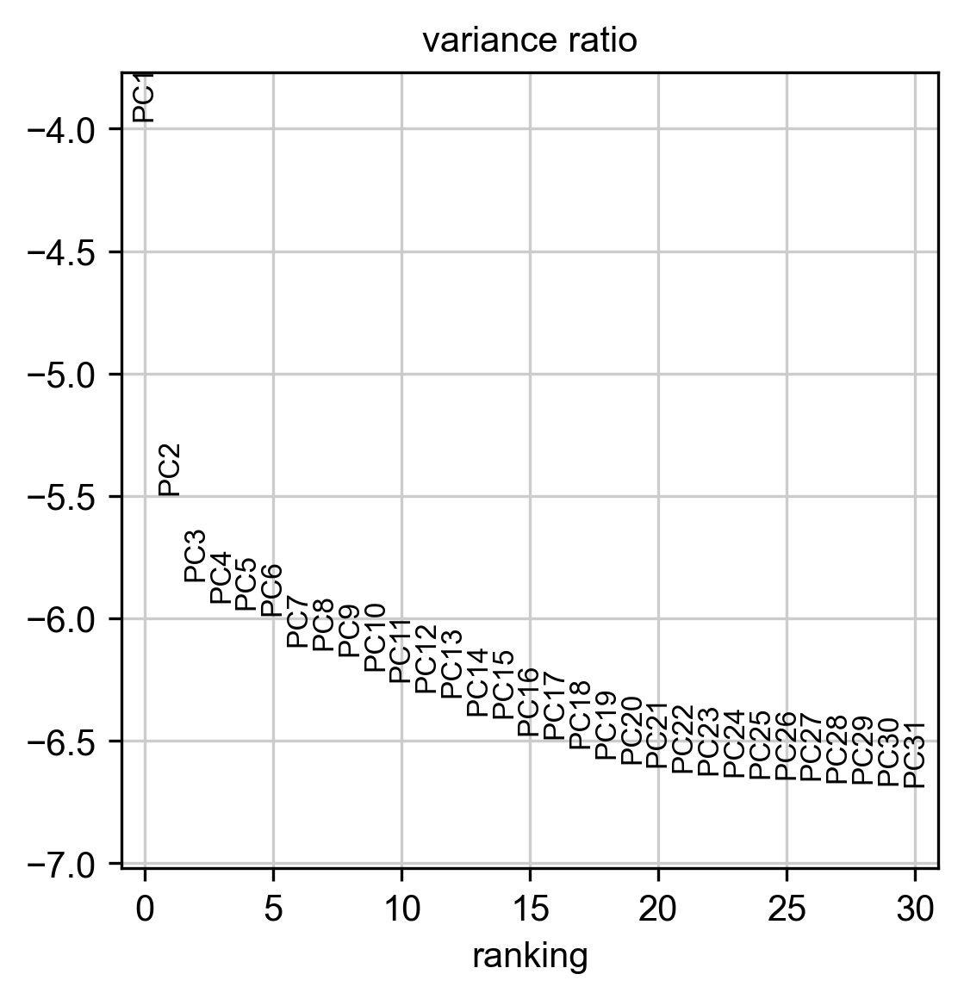

In [27]:
# adata = sc.read_h5ad( f_anndata_path )
# principal component analysis
sc.tl.pca(adata, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata, log=True)
adata.write( f_anndata_path )

In [28]:
# neighborhood graph of cells (determine optimal number of PCs here)
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=30)
# compute UMAP
sc.tl.umap(adata)
# tSNE
tsne = TSNE( n_jobs=20 )
adata.obsm['X_tsne'] = tsne.fit_transform( adata.X )
adata.write( f_anndata_path )

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:04)


running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 6 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


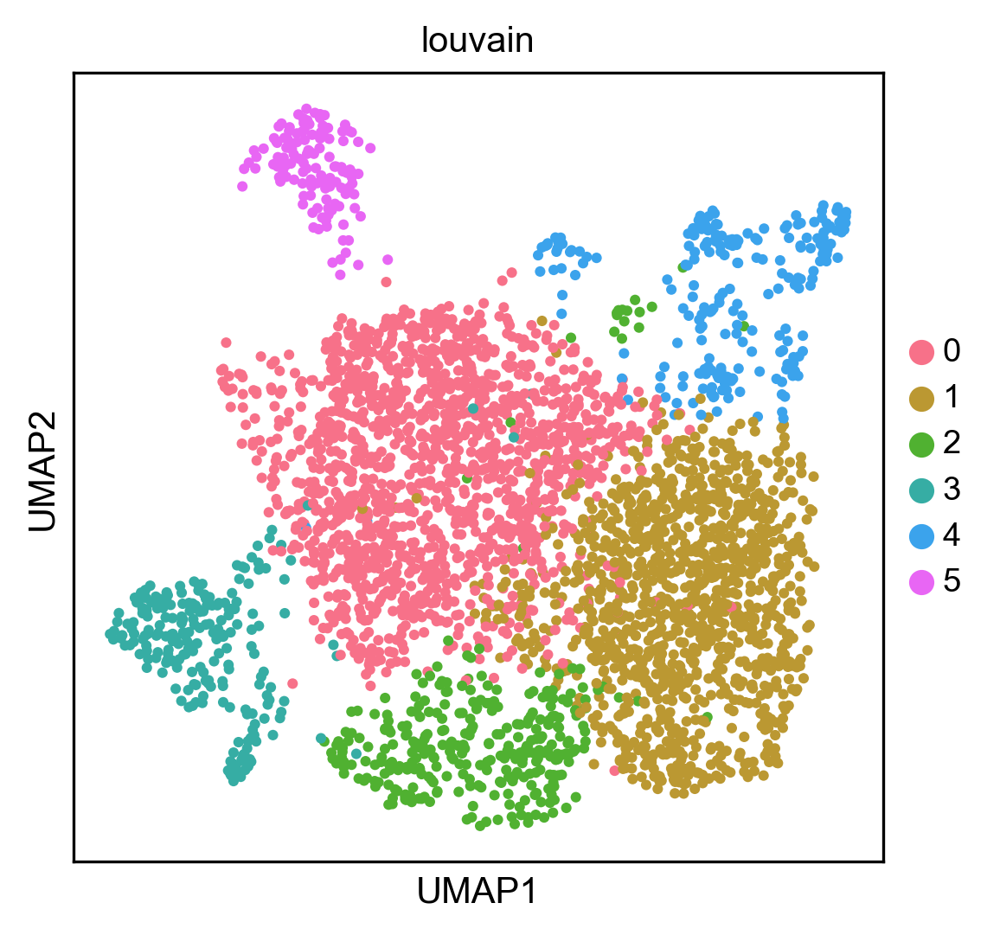

In [29]:
# cluster the neighbourhood graph
sc.tl.louvain(adata,resolution=0.4)

sc.pl.umap(adata, color=['louvain'] )

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


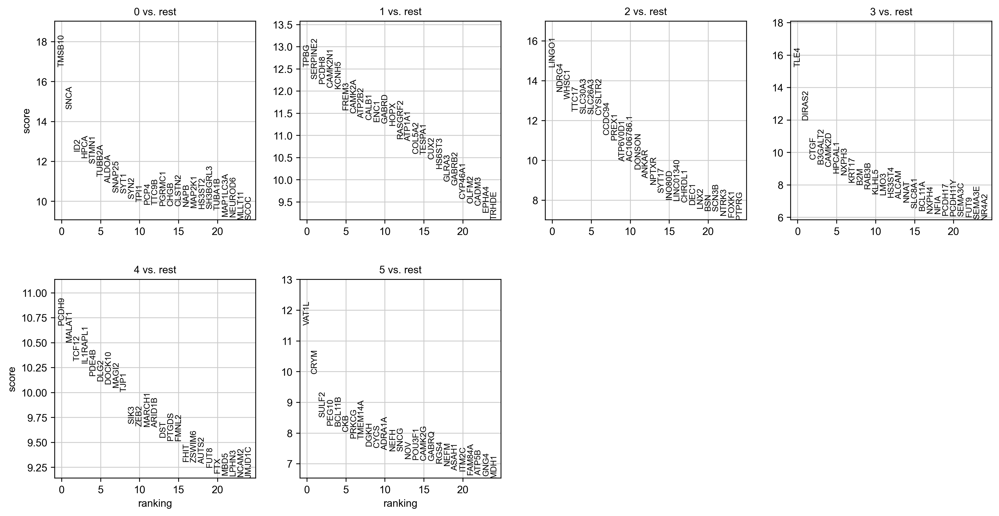

In [30]:
# find marker genes
sc.tl.rank_genes_groups(adata, 'louvain', method='t-test')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

# sc.tl.rank_genes_groups(adata, 'louvain', method='logreg')
# sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(10)
adata.write( f_anndata_path )

In [31]:
# Column names
cluster_col = 'CT_ann_ABM_MCA_scmap_cell2cluster_51_CTs'
score_col = 'CT_ann_score_ABM_MCA_scmap_cell2cluster_51_CTs'

# View the unique renamed cell types
unique_clusters = adata.obs[cluster_col].unique()
print("Unique new cluster annotations:")
print(unique_clusters)

# View the number of cells per new cluster
cluster_counts = adata.obs[cluster_col].value_counts()
print("\nCell counts per cluster:")
print(cluster_counts)

# Summary of the assignment scores
score_stats = adata.obs[score_col].describe()
print("\nScore summary:")
print(score_stats)

# Optional: combine the two into a grouped table
summary_df = (
    adata.obs[[cluster_col, score_col]]
    .groupby(cluster_col)
    .agg(
        n_cells=(score_col, 'count'),
        mean_score=(score_col, 'mean'),
        median_score=(score_col, 'median'),
        min_score=(score_col, 'min'),
        max_score=(score_col, 'max')
    )
    .sort_values("n_cells", ascending=False)
)
print("\nCluster-wise summary:")
display(summary_df)

Unique new cluster annotations:
['unassigned', 'Exc L6 FEZF2 P4HA3 or SLITRK6 or TBCC', 'Oligo L4-6 MOBP COL18A1 or OPALIN', 'OPC L1-6 MYT1', 'Astro L1-6 FGFR3 ETNPPL or L1 FGFR3 MT1G or FOS', 'Exc L5-6 THEMIS OR1J1 or TMEM233 or L6 THEMIS..., 'Exc L4-5 RORB HNRNPA1P46 or RPL31P31', 'Exc L3 LINC00507 PSRC1 or L3-5 LINC00507 SLN ..., 'Exc L6 FEZF2 ETV4 or TBC1D26 or KRT17']
Categories (9, object): ['Astro L1-6 FGFR3 ETNPPL or L1 FGFR3 MT1G or FOS', 'Exc L3 LINC00507 PSRC1 or L3-5 LINC00507 SLN ..., 'Exc L4-5 RORB HNRNPA1P46 or RPL31P31', 'Exc L5-6 THEMIS OR1J1 or TMEM233 or L6 THEMIS..., ..., 'Exc L6 FEZF2 P4HA3 or SLITRK6 or TBCC', 'OPC L1-6 MYT1', 'Oligo L4-6 MOBP COL18A1 or OPALIN', 'unassigned']

Cell counts per cluster:
CT_ann_ABM_MCA_scmap_cell2cluster_51_CTs
unassigned                                                                3506
Exc L5-6 THEMIS OR1J1 or TMEM233 or L6 THEMIS EGR3 or LINC00343             12
Exc L4-5 RORB HNRNPA1P46 or RPL31P31                               

/var/folders/3n/bg3b1qfs4jz9hnh_q29xp5k00000gn/T/ipykernel_23121/2752178095.py:23: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(cluster_col)


,n_cells,mean_score,median_score,min_score,max_score
CT_ann_ABM_MCA_scmap_cell2cluster_51_CTs,,,,,
Exc L5-6 THEMIS OR1J1 or TMEM233 or L6 THEMIS EGR3 or LINC00343,12,0.530710,0.521468,0.501581,0.584516
Exc L4-5 RORB HNRNPA1P46 or RPL31P31,9,0.555114,0.559149,0.503399,0.622787
OPC L1-6 MYT1,5,0.538163,0.529975,0.515473,0.584677
Exc L3 LINC00507 PSRC1 or L3-5 LINC00507 SLN or L2-3 LINC00507 RPL9P17,3,0.541079,0.542126,0.531876,0.549234
Astro L1-6 FGFR3 ETNPPL or L1 FGFR3 MT1G or FOS,2,0.537114,0.537114,0.501111,0.573118
Oligo L4-6 MOBP COL18A1 or OPALIN,2,0.515778,0.515778,0.512087,0.519469
Exc L6 FEZF2 ETV4 or TBC1D26 or KRT17,1,0.514420,0.514420,0.514420,0.514420
Exc L6 FEZF2 P4HA3 or SLITRK6 or TBCC,1,0.512093,0.512093,0.512093,0.512093
unassigned,0,NaN,NaN,NaN,NaN


In [32]:
import json
import zlib
import base64

# collect SCENIC AUCell output
lf = lp.connect( f_pyscenic_output, mode='r+', validate=False )
auc_mtx = pd.DataFrame( lf.ca.RegulonsAUC, index=lf.ca.CellID)
lf.close()

In [33]:
import umap

# UMAP
runUmap = umap.UMAP(n_neighbors=10, min_dist=0.4, metric='correlation').fit_transform
dr_umap = runUmap( auc_mtx )
pd.DataFrame(dr_umap, columns=['X', 'Y'], index=auc_mtx.index).to_csv( "NEN_scenic_umap.txt", sep='\t')
# tSNE
tsne = TSNE( n_jobs=20 )
dr_tsne = tsne.fit_transform( auc_mtx )
pd.DataFrame(dr_tsne, columns=['X', 'Y'], index=auc_mtx.index).to_csv( "NEN_scenic_tsne.txt", sep='\t')

In [34]:
# scenic output
lf = lp.connect( f_pyscenic_output, mode='r+', validate=False )
meta = json.loads(zlib.decompress(base64.b64decode( lf.attrs.MetaData )))
#exprMat = pd.DataFrame( lf[:,:], index=lf.ra.Gene, columns=lf.ca.CellID)
auc_mtx = pd.DataFrame( lf.ca.RegulonsAUC, index=lf.ca.CellID)
regulons = lf.ra.Regulons
dr_umap = pd.read_csv( 'NEN_scenic_umap.txt', sep='\t', header=0, index_col=0 )
dr_tsne = pd.read_csv( 'NEN_scenic_tsne.txt', sep='\t', header=0, index_col=0 )
###

In [35]:
auc_mtx.columns = auc_mtx.columns.str.replace('\(','_(')
regulons.dtype.names = tuple( [ x.replace("(","_(") for x in regulons.dtype.names ] )
# regulon thresholds
rt = meta['regulonThresholds']
for i,x in enumerate(rt):
    tmp = x.get('regulon').replace("(","_(")
    x.update( {'regulon': tmp} )

In [36]:
tsneDF = pd.DataFrame(adata.obsm['X_tsne'], columns=['_X', '_Y'])

Embeddings_X = pd.DataFrame( index=lf.ca.CellID )
Embeddings_X = pd.concat( [
        pd.DataFrame(adata.obsm['X_umap'],index=adata.obs.index)[0] ,
        pd.DataFrame(adata.obsm['X_pca'],index=adata.obs.index)[0] ,
        dr_tsne['X'] ,
        dr_umap['X']
    ], sort=False, axis=1, join='outer' )
Embeddings_X.columns = ['1','2','3','4']

Embeddings_Y = pd.DataFrame( index=lf.ca.CellID )
Embeddings_Y = pd.concat( [
        pd.DataFrame(adata.obsm['X_umap'],index=adata.obs.index)[1] ,
        pd.DataFrame(adata.obsm['X_pca'],index=adata.obs.index)[1] ,
        dr_tsne['Y'] ,
        dr_umap['Y']
    ], sort=False, axis=1, join='outer' )
Embeddings_Y.columns = ['1','2','3','4']

In [37]:
### metadata
metaJson = {}

metaJson['embeddings'] = [
    {
        "id": -1,
        "name": f"Scanpy t-SNE (highly variable genes)"
    },
    {
        "id": 1,
        "name": f"Scanpy UMAP  (highly variable genes)"
    },
    {
        "id": 2,
        "name": "Scanpy PC1/PC2"
    },
    {
        "id": 3,
        "name": "SCENIC AUC t-SNE"
    },
    {
        "id": 4,
        "name": "SCENIC AUC UMAP"
    },
]

metaJson["clusterings"] = [{
            "id": 0,
            "group": "Scanpy",
            "name": "Scanpy louvain default resolution",
            "clusters": [],
        }]

metaJson["metrics"] = [
        {
            "name": "nUMI"
        }, {
            "name": "nGene"
        }, {
            "name": "Percent_mito"
        }
]

metaJson["annotations"] = [
    {
        "name": "Louvain_clusters_Scanpy",
        "values": list(set( adata.obs['louvain'].astype(str) ))
    },
    {
        "name": "Cluster",
        "values": list(set(adata.obs['cluster'].values))
    },
    {
        "name": "Condition",
        "values": list(set(adata.obs['condition'].values))
    },
    {
        "name": "Sample",
        "values": list(set(adata.obs['sample'].values))
    }
]

# SCENIC regulon thresholds:
metaJson["regulonThresholds"] = rt

for i in range(max(set([int(x) for x in adata.obs['louvain']])) + 1):
    clustDict = {}
    clustDict['id'] = i
    clustDict['description'] = f'Unannotated Cluster {i + 1}'
    metaJson['clusterings'][0]['clusters'].append(clustDict)
    
clusterings = pd.DataFrame()
clusterings["0"] = adata.obs['louvain'].values.astype(np.int64)

In [38]:
def dfToNamedMatrix(df):
    arr_ip = [tuple(i) for i in df.values]
    dtyp = np.dtype(list(zip(df.dtypes.index, df.dtypes)))
    arr = np.array(arr_ip, dtype=dtyp)
    return arr

In [39]:
col_attrs = {
    "CellID": np.array(adata.obs.index),
    "nUMI": np.array(adata.obs['n_counts'].values),
    "nGene": np.array(adata.obs['n_genes'].values),
    "Louvain_clusters_Scanpy": np.array( adata.obs['louvain'].values ),
    "Cluster": np.array(adata.obs['cluster'].values),
    "Condition": np.array(adata.obs['condition'].values),
    "Sample": np.array(adata.obs['sample'].values),
    "Percent_mito": np.array(adata.obs['percent_mito'].values),
    "Embedding": dfToNamedMatrix(tsneDF),
    "Embeddings_X": dfToNamedMatrix(Embeddings_X),
    "Embeddings_Y": dfToNamedMatrix(Embeddings_Y),
    "RegulonsAUC": dfToNamedMatrix(auc_mtx),
    "Clusterings": dfToNamedMatrix(clusterings),
    "ClusterID": np.array(adata.obs['louvain'].values)
}

row_attrs = {
    "Gene": lf.ra.Gene,
    "Regulons": regulons,
}

attrs = {
    "title": "sampleTitle",
    "MetaData": json.dumps(metaJson),
    "Genome": 'hg38',
    "SCopeTreeL1": "",
    "SCopeTreeL2": "",
    "SCopeTreeL3": ""
}

# compress the metadata field:
attrs['MetaData'] = base64.b64encode(zlib.compress(json.dumps(metaJson).encode('ascii'))).decode('ascii')

In [40]:
lp.create(
    filename = f_final_loom ,
    layers=lf[:,:],
    row_attrs=row_attrs, 
    col_attrs=col_attrs, 
    file_attrs=attrs
)
lf.close() # close original pyscenic loom file

In [41]:
# Create a new column with the 'cell_' prefix
adata.obs['cell_id'] = 'cell_' + adata.obs['obs_names'].astype(str)

# Select the columns to save
data_to_save = adata.obs[['cell_id', 'cluster']]

# Save as a .csv file
csv_file_path = 'Data/NEN_I/NEN_I_cell_cluster_identifiers.csv'
data_to_save.to_csv(csv_file_path, index=False)

In [42]:
import json
import base64
import zlib
from pyscenic.plotting import plot_binarization
from pyscenic.export import add_scenic_metadata
from pyscenic.cli.utils import load_signatures
import matplotlib as mpl

In [43]:
# scenic output
lf = lp.connect( f_final_loom, mode='r', validate=False )
meta = json.loads(zlib.decompress(base64.b64decode( lf.attrs.MetaData )))
exprMat = pd.DataFrame( lf[:,:], index=lf.ra.Gene, columns=lf.ca.CellID).T
auc_mtx = pd.DataFrame( lf.ca.RegulonsAUC, index=lf.ca.CellID)

In [44]:
# Create a DataFrame from the regulons data
regulons_df = pd.DataFrame(lf.ra.Regulons, index=lf.ra.Gene)

# Create a dictionary of regulons
regulons = {}
for index, row in regulons_df.iterrows():
    # Assuming the regulon data is binary (1 or 0)
    regulons[index] = list(row[row == 1].index.values)

# Now `regulons` is a dictionary where keys are gene names and values are lists of regulons

In [45]:
print(lf.ca.keys())

['CellID', 'Cluster', 'ClusterID', 'Clusterings', 'Condition', 'Embedding', 'Embeddings_X', 'Embeddings_Y', 'Louvain_clusters_Scanpy', 'Percent_mito', 'RegulonsAUC', 'Sample', 'nGene', 'nUMI']


In [46]:
# cell annotations from the loom column attributes:
cellAnnot = pd.concat(
    [
        pd.DataFrame( lf.ca.Clusterings, index=lf.ca.CellID ),
        pd.DataFrame( lf.ca.ClusterID, index=lf.ca.CellID ),
        pd.DataFrame( lf.ca.Louvain_clusters_Scanpy, index=lf.ca.CellID ),
        pd.DataFrame( lf.ca.Cluster, index=lf.ca.CellID ),
        pd.DataFrame( lf.ca.Condition, index=lf.ca.CellID ),
        pd.DataFrame(lf.ca.Sample, index=lf.ca.CellID ),
        pd.DataFrame( lf.ca.Percent_mito, index=lf.ca.CellID ),
        pd.DataFrame( lf.ca.nGene, index=lf.ca.CellID ),
        pd.DataFrame( lf.ca.nUMI, index=lf.ca.CellID ),
    ],
    axis=1
)
cellAnnot.columns = [
 'Clusterings',
 'ClusterID',
 'Louvain_clusters_Scanpy',
 'Cluster',
 'Condition',
 'Sample',
 'Percent_mito',
 'nGene',
 'nUMI']

In [47]:
# capture embeddings:
dr = [
    pd.DataFrame( lf.ca.Embedding, index=lf.ca.CellID )
]
dr_names = [
    meta['embeddings'][0]['name'].replace(" ","_")
]

# add other embeddings
drx = pd.DataFrame( lf.ca.Embeddings_X, index=lf.ca.CellID )
dry = pd.DataFrame( lf.ca.Embeddings_Y, index=lf.ca.CellID )

for i in range( len(drx.columns) ):
    dr.append( pd.concat( [ drx.iloc[:,i], dry.iloc[:,i] ], sort=False, axis=1, join='outer' ))
    dr_names.append( meta['embeddings'][i+1]['name'].replace(" ","_").replace('/','-') )

# rename columns:
for i,x in enumerate( dr ):
    x.columns = ['X','Y']

In [48]:
lf.close()

In [50]:
from pyscenic.utils import load_motifs

df_motifs = load_motifs('Data/NEN_I/NEN_I_reg.csv')

In [51]:
def colorMap( x, palette='bright' ):
    import natsort
    from collections import OrderedDict
    #
    n=len(set(x))
    cpalette = sns.color_palette(palette,n_colors=n )
    cdict = dict( zip( list(set(x)), cpalette ))
    cmap = [ cdict[i] for i in x ]
    cdict = OrderedDict( natsort.natsorted(cdict.items()) )
    return cmap,cdict

def drplot( dr, colorlab, ax, palette='bright', title=None, **kwargs ):
    cmap,cdict = colorMap( colorlab, palette )
    for lab,col in cdict.items():  
        ix = colorlab.loc[colorlab==lab].index
        ax.scatter( dr['X'][ix], dr['Y'][ix], c=[col]*len(ix), alpha=0.7, label=lab, edgecolors='none')
    if( title is not None ):
        ax.set_title(title, fontsize='x-large');
    #
    ax.set_xticks([])
    ax.set_yticks([])
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)

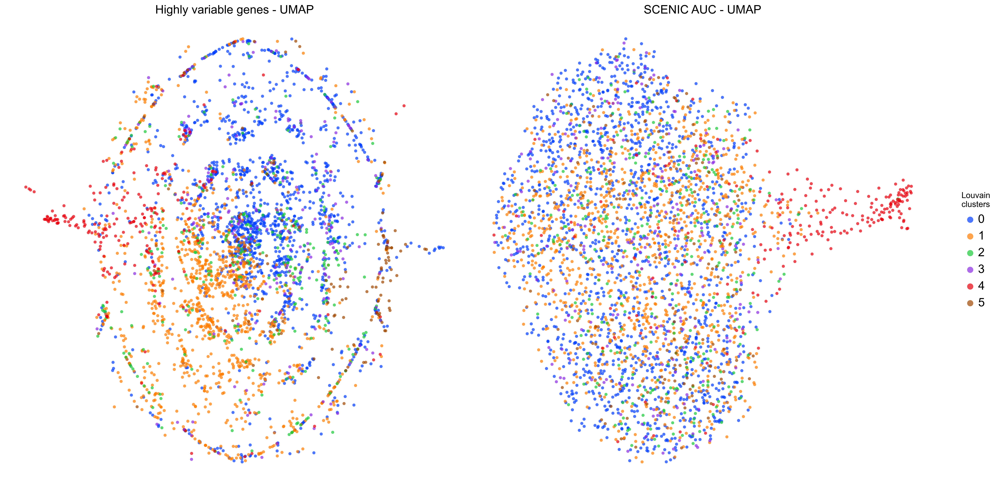

In [52]:
plt.rcParams.update({'font.size': 12})

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10), dpi=150)

# Plot using drplot without specifying 's'
drplot(dr[0], colorlab=cellAnnot['Louvain_clusters_Scanpy'], ax=ax1, palette='bright', title='Highly variable genes - UMAP')
drplot(dr[4], colorlab=cellAnnot['Louvain_clusters_Scanpy'], ax=ax2, palette='bright', title='SCENIC AUC - UMAP')

# Adjust dot size using Matplotlib's scatter method
for ax in [ax1, ax2]:
    for collection in ax.collections:
        collection.set_sizes([20])  # Set the size of the dots; adjust the value as needed

ax2.legend(loc='right', bbox_to_anchor=(1.15, 0.5), ncol=1, markerscale=2, fontsize='x-large', frameon=False, title="Louvain\nclusters")

plt.tight_layout()
plt.savefig("Results/NEN_I/NEN_I_dimred_umap-hvg-scenic-louvain.png", dpi=300, bbox_inches="tight")
plt.show()

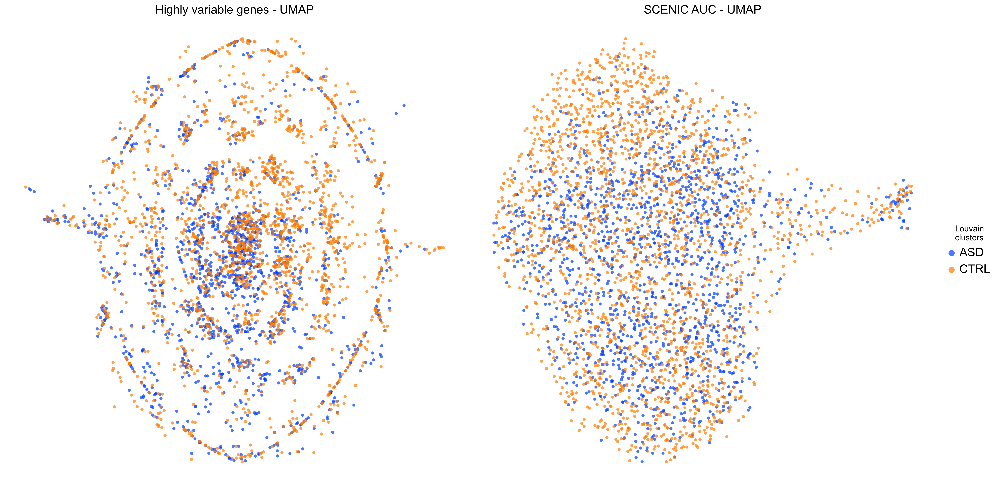

In [53]:
plt.rcParams.update({'font.size': 12})

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10), dpi=150)

# Plot using drplot without specifying 's'
drplot(dr[0], colorlab=cellAnnot['Condition'], ax=ax1, palette='bright', title='Highly variable genes - UMAP')
drplot(dr[4], colorlab=cellAnnot['Condition'], ax=ax2, palette='bright', title='SCENIC AUC - UMAP')

# Adjust dot size using Matplotlib's scatter method
for ax in [ax1, ax2]:
    for collection in ax.collections:
        collection.set_sizes([20])  # Set the size of the dots; adjust the value as needed

ax2.legend(loc='right', bbox_to_anchor=(1.15, 0.5), ncol=1, markerscale=2, fontsize='x-large', frameon=False, title="Louvain\nclusters")

plt.tight_layout()
plt.savefig("Results/NEN_I/NEN_I_Sample_dimred_umap-hvg-scenic-louvain.png", dpi=300, bbox_inches="tight")
plt.show()

In [54]:
from pyscenic.rss import regulon_specificity_scores
from pyscenic.plotting import plot_rss
from pyscenic.binarization import binarize

In [55]:
from math import sqrt
import numpy as np
import pandas as pd
from scipy.spatial.distance import jensenshannon

def regulon_specificity_scores(auc_mtx, cell_type_series):
    """
    Calculates the Regulon Specificity Scores (RSS).

    :param auc_mtx: DataFrame with AUC values for all cells and regulons (n_cells x n_regulons).
    :param cell_type_series: Pandas Series with cell identifiers as index and cell type labels as values.
    :return: DataFrame with RSS values (cell type x regulon).
    """
    # Get unique cell types
    cell_types = list(cell_type_series.unique())
    n_types = len(cell_types)

    # Get regulons from the AUC matrix
    regulons = list(auc_mtx.columns)
    n_regulons = len(regulons)

    # Initialize the RSS values array
    rss_values = np.empty(shape=(n_types, n_regulons), dtype=float)

    def rss(aucs, labels):
        # Calculate RSS using Jensen-Shannon divergence
        return 1.0 - jensenshannon(aucs / aucs.sum(), labels / labels.sum())

    # Calculate RSS for each regulon and cell type
    for cidx, regulon_name in enumerate(regulons):
        for ridx, cell_type in enumerate(cell_types):
            aucs = auc_mtx[regulon_name].values
            labels = (cell_type_series == cell_type).astype(int)
            rss_values[ridx, cidx] = rss(aucs, labels)

    # Return the RSS values as a DataFrame
    return pd.DataFrame(data=rss_values, index=cell_types, columns=regulons)

In [56]:
rss_cellType = regulon_specificity_scores( auc_mtx, cellAnnot['Condition'] )
rss_cellType

,AR(+),ARID3A(+),ASCL1(+),ATF1(+),ATF2(+),ATF3(+),ATF4(+),BACH1(+),BCL6(+),BCLAF1(+),...,ZNF704(+),ZNF737(+),ZNF770(+),ZNF778(+),ZNF790(+),ZNF814(+),ZNF84(+),ZSCAN31(+),ZSCAN5A(+),ZXDB(+)
CTRL,0.396497,0.344969,0.550857,0.493023,0.331673,0.535352,0.577778,0.553416,0.553824,0.400843,...,0.551835,0.454186,0.549217,0.426744,0.214634,0.437307,0.432467,0.261086,0.551276,0.480877
ASD,0.390398,0.331206,0.503119,0.461471,0.306737,0.500881,0.491280,0.497357,0.497749,0.358279,...,0.495572,0.405177,0.507292,0.386817,0.223855,0.381967,0.421409,0.233001,0.490251,0.450231


Looks like you are using a tranform that doesn't support FancyArrowPatch, using ax.annotate instead. The arrows might strike through texts. Increasing shrinkA in arrowprops might help.


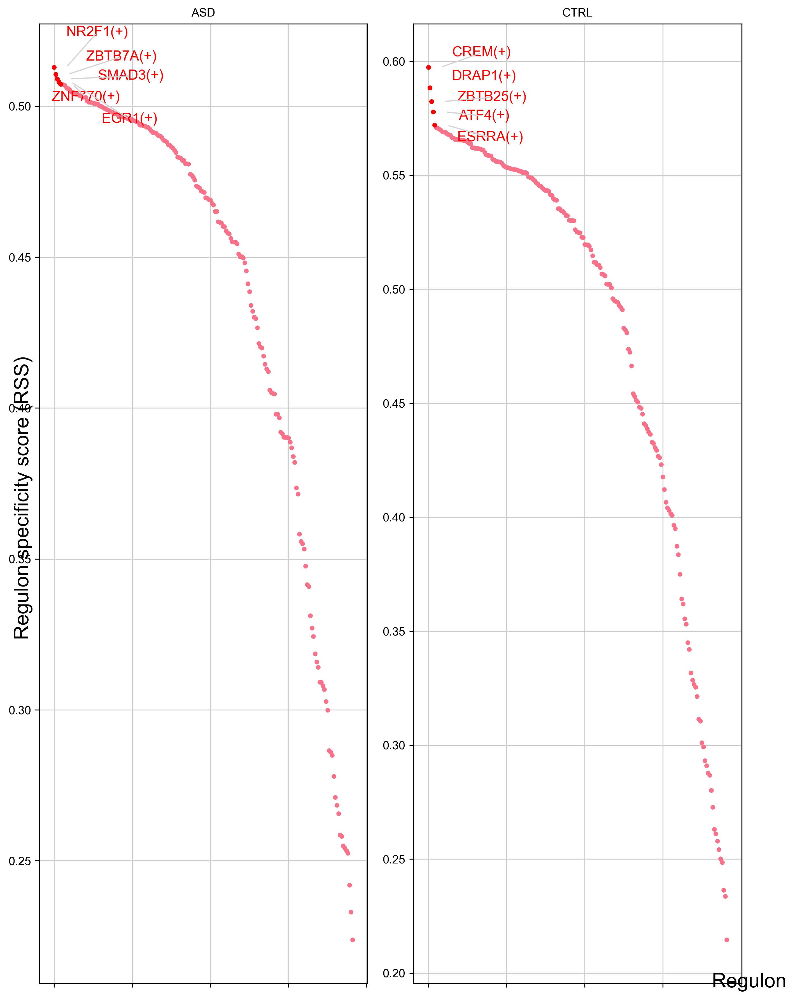

In [57]:
from adjustText import adjust_text

# Define the categories
cats = sorted(list(set(cellAnnot['Condition'])))

# Create the figure with a layout that fits 11 panels
fig = plt.figure(figsize=(18, 12))  # Adjust the figure size as needed

# Determine the number of rows and columns needed
n_panels = len(cats)
ncols = 4  # You can adjust this based on your preference
nrows = (n_panels + ncols - 1) // ncols  # Ceiling division to ensure enough rows

# Iterate over categories and create subplots
for c, num in zip(cats, range(1, n_panels + 1)):
    x = rss_cellType.T[c]
    ax = fig.add_subplot(nrows, ncols, num)
    plot_rss(rss_cellType, c, top_n=5, max_n=None, ax=ax)
    ax.set_ylim(x.min() - (x.max() - x.min()) * 0.05, x.max() + (x.max() - x.min()) * 0.05)

    # Set font size for texts
    for t in ax.texts:
        t.set_fontsize(12)

    # Remove axis labels
    ax.set_ylabel('')
    ax.set_xlabel('')

    # Adjust text to prevent overlap
    adjust_text(ax.texts, autoalign='xy', ha='right', va='bottom',
                arrowprops=dict(arrowstyle='-', color='lightgrey'), precision=0.001)

# Set figure-wide labels
fig.text(0.5, 0.02, 'Regulon', ha='center', va='center', size='x-large')
fig.text(0.02, 0.5, 'Regulon specificity score (RSS)', ha='center', va='center',
         rotation='vertical', size='x-large')

# Adjust layout and save the figure
plt.tight_layout()
plt.rcParams.update({
    'figure.autolayout': True,
    'figure.titlesize': 'large',
    'axes.labelsize': 'medium',
    'axes.titlesize': 'large',
    'xtick.labelsize': 'medium',
    'ytick.labelsize': 'medium'
})
#plt.savefig("Results/NEN_I/NEN_I_cellType-RSS-top5.png", dpi=300, bbox_inches="tight")
plt.show()

In [58]:
# Compute the z-scores for each column
z_scores = {col: (auc_mtx[col] - auc_mtx[col].mean()) / auc_mtx[col].std(ddof=0) for col in auc_mtx.columns}

# Convert the dictionary of z-scores to a DataFrame
auc_mtx_Z = pd.DataFrame(z_scores, index=auc_mtx.index)

# Optionally, sort the index if needed
# auc_mtx_Z.sort_index(inplace=True)

# Now auc_mtx_Z contains the z-scores for each column

In [59]:
def palplot(pal, names, colors=None, size=1):
    n = len(pal)
    f, ax = plt.subplots(1, 1, figsize=(n * size, size))
    ax.imshow(np.arange(n).reshape(1, n),
              cmap=mpl.colors.ListedColormap(list(pal)),
              interpolation="nearest", aspect="auto")
    ax.set_xticks(np.arange(n) - .5)
    ax.set_yticks([-.5, .5])
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    colors = n * ['k'] if colors is None else colors
    for idx, (name, color) in enumerate(zip(names, colors)):
        ax.text(0.0+idx, 0.0, name, color=color, horizontalalignment='center', verticalalignment='center')
    return f

In [60]:
colors = sns.color_palette('bright',n_colors=len(cats) )
colorsd = dict( zip( cats, colors ))
colormap = [ colorsd[x] for x in cellAnnot['Condition'] ]

/opt/anaconda3/envs/scenic_env_py310/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/opt/anaconda3/envs/scenic_env_py310/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


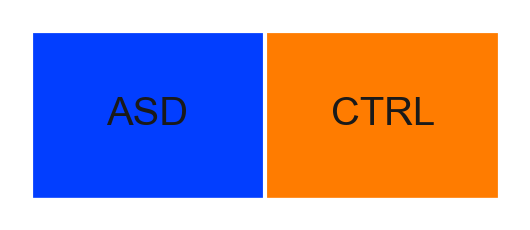

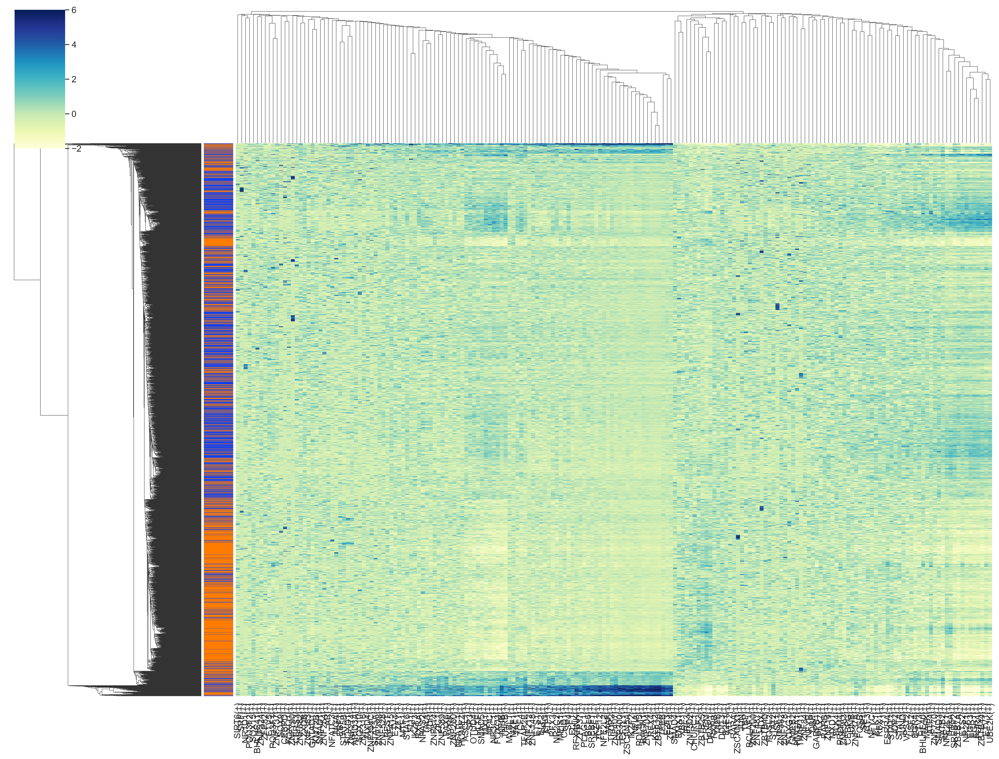

In [61]:
# Set the font scale
sns.set(font_scale=0.8)
fig = palplot(colors, cats, size=1.0)
plt.savefig("Results/NEN_I/NEN_I_regulon-heatmap-legend.png", dpi=300, bbox_inches="tight")

sns.set(font_scale=1.2)
g = sns.clustermap(auc_mtx_Z, annot=False,  square=False,  linecolor='gray',
    yticklabels=False, xticklabels=True, vmin=-2, vmax=6, row_colors=colormap,
    cmap="YlGnBu", figsize=(21,16) )
g.cax.set_visible(True)
g.ax_heatmap.set_ylabel('')
g.ax_heatmap.set_xlabel('')

# Save the figure
plt.savefig("Results/NEN_I/NEN_I_regulon-heatmap.png", dpi=300, bbox_inches="tight")

/opt/anaconda3/envs/scenic_env_py310/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/opt/anaconda3/envs/scenic_env_py310/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


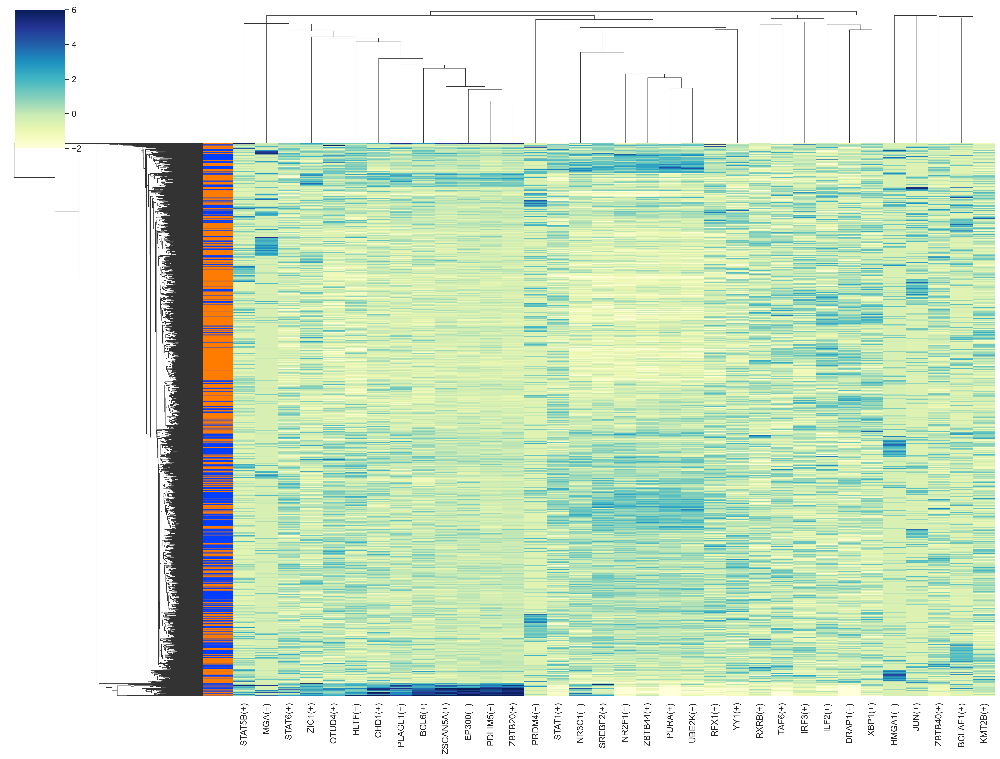

In [63]:
# Step 1: Load subset of regulons
regulon_list = pd.read_csv("Data/NEN_I/NEN_I_rbp_regulons_target_AUC_rank.tsv", sep="\t")['regulon'].unique()

# Step 2: Filter AUC matrix to include only those regulons
auc_subset = auc_mtx_Z.loc[:, auc_mtx_Z.columns.intersection(regulon_list)]

# Step 3: Plot clustermap
sns.set(font_scale=1.2)
g = sns.clustermap(
    auc_subset,
    annot=False,
    square=False,
    linecolor='gray',
    yticklabels=False,
    xticklabels=True,
    vmin=-2,
    vmax=6,
    row_colors=colormap,  # optional, if still aligned
    cmap="YlGnBu",
    figsize=(21, 16)
)
g.cax.set_visible(True)
g.ax_heatmap.set_ylabel('')
g.ax_heatmap.set_xlabel('')

# Save
plt.savefig("Results/NEN_I/NEN_I_regulon-heatmap-subset.png", dpi=300, bbox_inches="tight")

/opt/anaconda3/envs/scenic_env_py310/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/opt/anaconda3/envs/scenic_env_py310/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


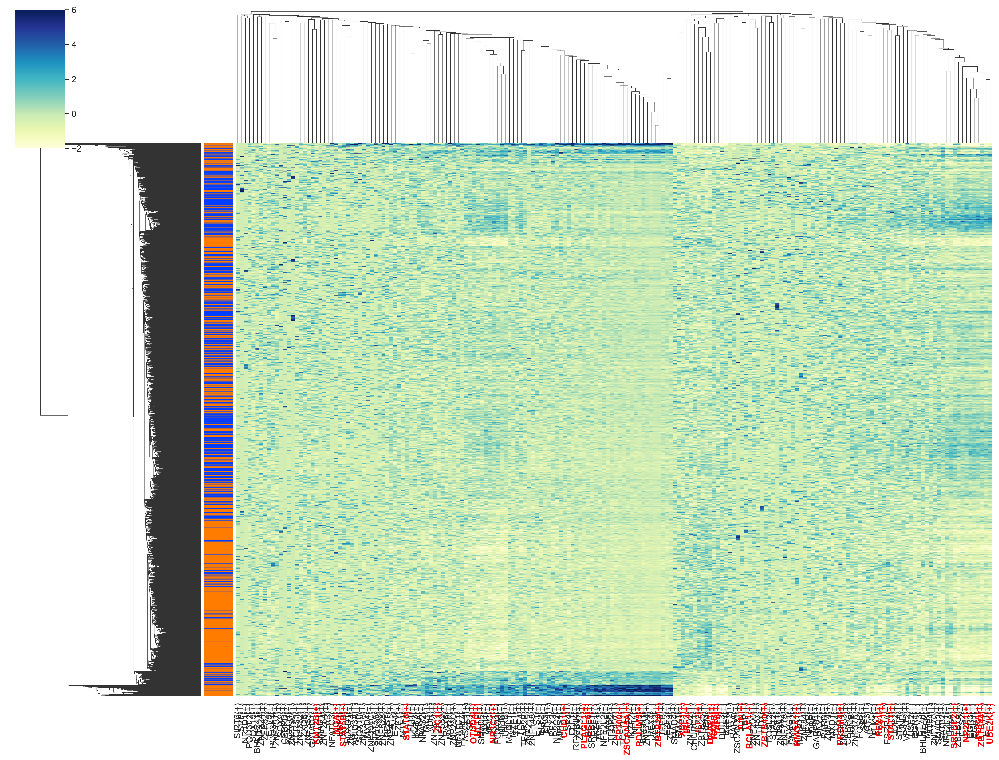

In [64]:
# Plot clustermap
sns.set(font_scale=1.2)
g = sns.clustermap(
    auc_mtx_Z,
    annot=False,
    square=False,
    linecolor='gray',
    yticklabels=False,
    xticklabels=True,
    vmin=-2,
    vmax=6,
    row_colors=colormap,
    cmap="YlGnBu",
    figsize=(21, 16)
)
g.cax.set_visible(True)
g.ax_heatmap.set_ylabel('')
g.ax_heatmap.set_xlabel('')

# Highlight columns by changing tick label color
for label in g.ax_heatmap.get_xticklabels():
    if label.get_text() in regulon_list:
        label.set_color("red")
        label.set_fontweight("bold")

plt.savefig("Results/NEN_I/NEN_I_regulon-heatmap-highlighted.png", dpi=300, bbox_inches="tight")

In [65]:
print("Available regulons in auc_mtx_Z:", auc_mtx_Z.columns.tolist())

Available regulons in auc_mtx_Z: ['AR(+)', 'ARID3A(+)', 'ASCL1(+)', 'ATF1(+)', 'ATF2(+)', 'ATF3(+)', 'ATF4(+)', 'BACH1(+)', 'BCL6(+)', 'BCLAF1(+)', 'BHLHE40(+)', 'BHLHE41(+)', 'CEBPD(+)', 'CEBPG(+)', 'CERS3(+)', 'CHD1(+)', 'CHURC1(+)', 'CREM(+)', 'DBP(+)', 'DDIT3(+)', 'DRAP1(+)', 'E2F1(+)', 'E2F3(+)', 'EBF1(+)', 'EGR1(+)', 'EGR3(+)', 'EGR4(+)', 'ELF1(+)', 'ELF2(+)', 'ELK1(+)', 'ELK4(+)', 'EMX1(+)', 'EP300(+)', 'ERG(+)', 'ESRRA(+)', 'ETS1(+)', 'ETS2(+)', 'ETV1(+)', 'ETV3(+)', 'ETV4(+)', 'ETV5(+)', 'FLI1(+)', 'FOSB(+)', 'FOSL2(+)', 'FOXD1(+)', 'FOXG1(+)', 'FOXO1(+)', 'FOXO3(+)', 'GABPB1(+)', 'GATAD1(+)', 'GMEB2(+)', 'HDX(+)', 'HLTF(+)', 'HMGA1(+)', 'HOMEZ(+)', 'HSF1(+)', 'IKZF1(+)', 'IKZF2(+)', 'IKZF3(+)', 'ILF2(+)', 'IRF3(+)', 'JDP2(+)', 'JUN(+)', 'JUNB(+)', 'JUND(+)', 'KLF12(+)', 'KMT2B(+)', 'MAF(+)', 'MAFK(+)', 'MEIS1(+)', 'MGA(+)', 'MTF1(+)', 'MXD1(+)', 'MXD4(+)', 'MXI1(+)', 'MYBL1(+)', 'MYRF(+)', 'MZF1(+)', 'NFATC1(+)', 'NFATC3(+)', 'NFE2L1(+)', 'NFE2L2(+)', 'NFIA(+)', 'NFIB(+)', 'N

In [67]:
from scipy.stats import mannwhitneyu
from statsmodels.stats.multitest import multipletests

results = []

# For each regulon (i.e., each column in auc_mtx_Z)
for regulon in auc_mtx_Z.columns:
    x = auc_mtx_Z.loc[cellAnnot["Condition"] == "ASD", regulon]
    y = auc_mtx_Z.loc[cellAnnot["Condition"] == "CTRL", regulon]
    
  # Perform two-sided Mann–Whitney U test
    stat, pval = mannwhitneyu(x, y, alternative='two-sided')

    # Mean difference for effect size
    mean_diff = x.mean() - y.mean()
    
    results.append((regulon, pval, mean_diff))

# Convert to DataFrame
df_stats = pd.DataFrame(results, columns=["regulon", "p_value", "mean_difference"])

# Adjust p-values
df_stats["adj_p_value"] = multipletests(df_stats["p_value"], method="fdr_bh")[1]

# Sort by adjusted p-value
df_stats = df_stats.sort_values("adj_p_value")

df_stats

,regulon,p_value,mean_difference,adj_p_value
24,EGR1(+),4.172805e-146,0.746496,8.011785e-144
90,NR2F1(+),5.281816e-132,0.794956,5.070543e-130
17,CREM(+),2.811615e-128,-0.777119,1.799433e-126
154,ZBTB7A(+),1.380264e-119,0.773498,6.625265e-118
100,PURA(+),2.117174e-119,0.679084,8.129947e-118
...,...,...,...,...
185,ZNF778(+),8.341104e-01,0.031430,8.518574e-01
132,TAF6(+),8.558464e-01,-0.016285,8.694313e-01
183,ZNF737(+),8.638004e-01,-0.009049,8.728930e-01
66,KMT2B(+),9.309383e-01,-0.006251,9.358124e-01


In [68]:
significant_regs = df_stats[df_stats["adj_p_value"] < 0.05]["regulon"]
print(significant_regs.head())

24       EGR1(+)
90      NR2F1(+)
17       CREM(+)
154    ZBTB7A(+)
100      PURA(+)
Name: regulon, dtype: object


In [69]:
print("Original auc_mtx_Z shape:", auc_mtx_Z.shape)
print("Number of significant regulons:", len(significant_regs))
print("Subset shape:", auc_mtx_Z[significant_regs].shape)

Original auc_mtx_Z shape: (3541, 192)
Number of significant regulons: 133
Subset shape: (3541, 133)


In [70]:
cleaned_columns = auc_mtx_Z.columns.str.replace(r'[\(\)_+]', '', regex=True).str.upper()
cleaned_significant = significant_regs.str.replace(r'[\(\)_+]', '', regex=True).str.upper()

filtered_cols = auc_mtx_Z.columns[cleaned_columns.isin(cleaned_significant)]
auc_mtx_Z_sig = auc_mtx_Z[filtered_cols]

/opt/anaconda3/envs/scenic_env_py310/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/opt/anaconda3/envs/scenic_env_py310/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


Text(0.5, -110.68333333333334, '')

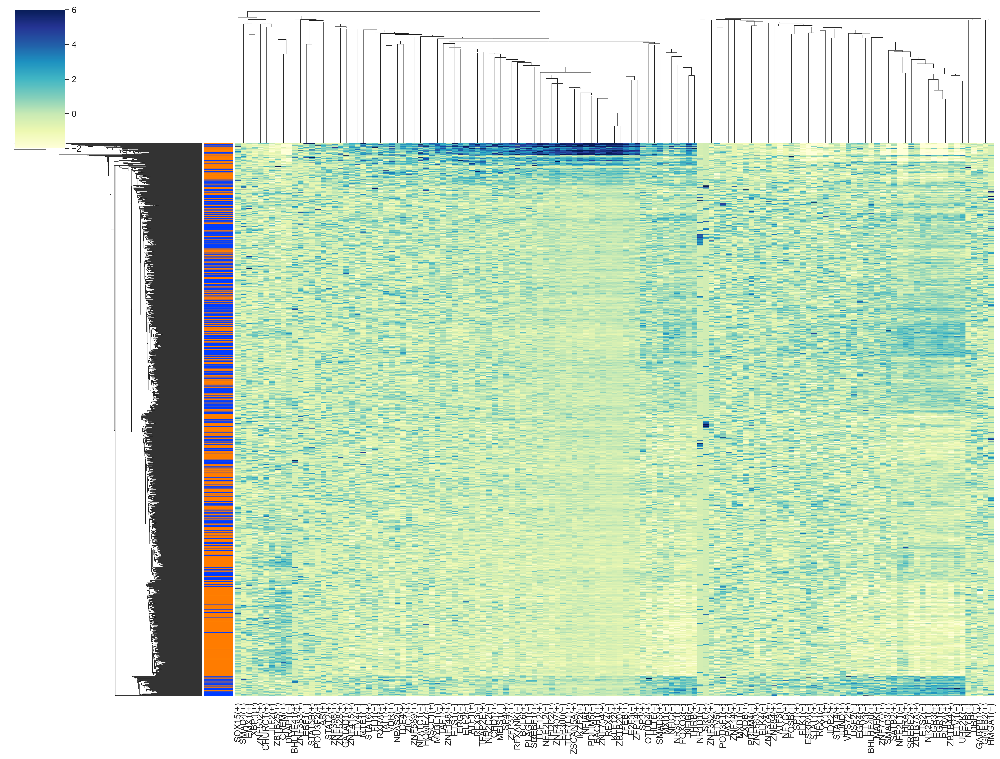

In [71]:
# Assuming you want the same colors per condition (row_colors = colormap)
sns.set(font_scale=1.2)
g = sns.clustermap(auc_mtx_Z_sig, annot=False, square=False, linecolor='gray',
    yticklabels=False, xticklabels=True, vmin=-2, vmax=6, row_colors=colormap,
    cmap="YlGnBu", figsize=(21,16))
g.cax.set_visible(True)
g.ax_heatmap.set_ylabel('')
g.ax_heatmap.set_xlabel('')

/opt/anaconda3/envs/scenic_env_py310/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/opt/anaconda3/envs/scenic_env_py310/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


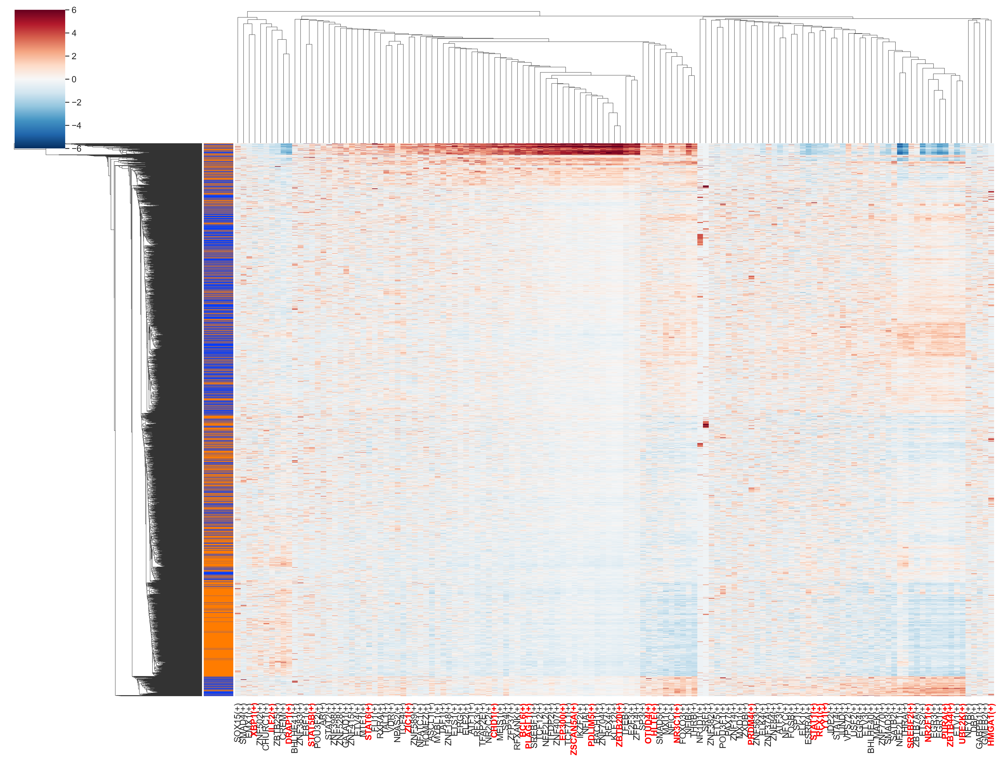

In [72]:
import matplotlib.colors as mcolors

# Custom diverging colormap centered at 0
div_norm = mcolors.TwoSlopeNorm(vmin=-6, vcenter=0, vmax=6)

# Plot clustermap with diverging colormap
sns.set(font_scale=1.2)
g = sns.clustermap(
    auc_mtx_Z_sig,
    annot=False,
    square=False,
    linecolor='gray',
    yticklabels=False,
    xticklabels=True,
    vmin=-6,
    vmax=6,
    norm=div_norm,
    row_colors=colormap,
    cmap="RdBu_r",
    figsize=(21, 16)
)
g.cax.set_visible(True)
g.ax_heatmap.set_ylabel('')
g.ax_heatmap.set_xlabel('')

# Highlight RBP regulons in red
for label in g.ax_heatmap.get_xticklabels():
    if label.get_text() in regulon_list:
        label.set_color("red")
        label.set_fontweight("bold")

# Save figure
plt.savefig("Results/NEN_I/NEN_I_regulon-heatmap-highlighted-diverging.png", dpi=300, bbox_inches="tight")

/opt/anaconda3/envs/scenic_env_py310/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/opt/anaconda3/envs/scenic_env_py310/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


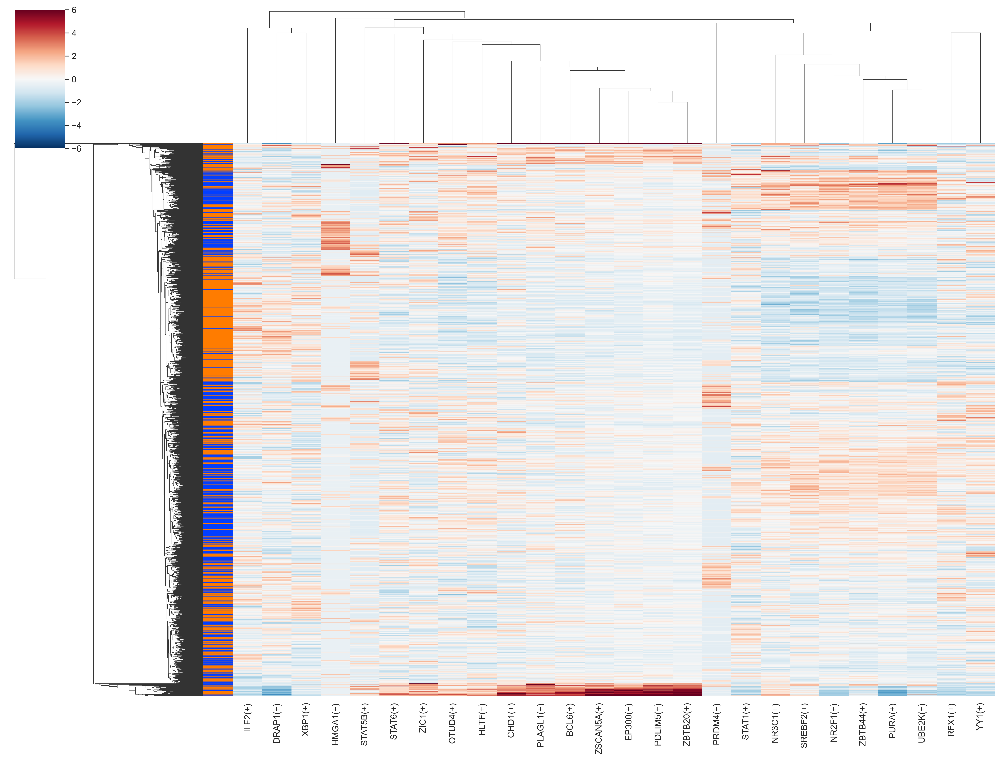

In [73]:
div_norm = mcolors.TwoSlopeNorm(vmin=-6, vcenter=0, vmax=6)

# Step 1: Filter AUC matrix to include only those regulons
auc_subset2 = auc_mtx_Z_sig.loc[:, auc_mtx_Z_sig.columns.intersection(regulon_list)]

# Step 2: Plot clustermap
sns.set(font_scale=1.2)
g = sns.clustermap(
    auc_subset2,
    annot=False,
    square=False,
    linecolor='gray',
    yticklabels=False,
    xticklabels=True,
    vmin=-6,
    vmax=6,
    row_colors=colormap,  # optional, if still aligned
    cmap="RdBu_r",
    figsize=(21, 16)
)
g.cax.set_visible(True)
g.ax_heatmap.set_ylabel('')
g.ax_heatmap.set_xlabel('')

# Save
plt.savefig("Results/NEN_I/NEN_I_RBPregulon-heatmap-signifcant.png", dpi=300, bbox_inches="tight")

In [74]:
print(auc_subset2.columns.tolist())

['BCL6(+)', 'CHD1(+)', 'DRAP1(+)', 'EP300(+)', 'HLTF(+)', 'HMGA1(+)', 'ILF2(+)', 'NR2F1(+)', 'NR3C1(+)', 'OTUD4(+)', 'PDLIM5(+)', 'PLAGL1(+)', 'PRDM4(+)', 'PURA(+)', 'RFX1(+)', 'SREBF2(+)', 'STAT1(+)', 'STAT5B(+)', 'STAT6(+)', 'UBE2K(+)', 'XBP1(+)', 'YY1(+)', 'ZBTB20(+)', 'ZBTB44(+)', 'ZIC1(+)', 'ZSCAN5A(+)']


In [75]:
# Option 1: Print as a list
cleaned_regulons = [reg.replace("(+)", "").strip() for reg in auc_subset2.columns]
print(cleaned_regulons)

['BCL6', 'CHD1', 'DRAP1', 'EP300', 'HLTF', 'HMGA1', 'ILF2', 'NR2F1', 'NR3C1', 'OTUD4', 'PDLIM5', 'PLAGL1', 'PRDM4', 'PURA', 'RFX1', 'SREBF2', 'STAT1', 'STAT5B', 'STAT6', 'UBE2K', 'XBP1', 'YY1', 'ZBTB20', 'ZBTB44', 'ZIC1', 'ZSCAN5A']


/opt/anaconda3/envs/scenic_env_py310/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


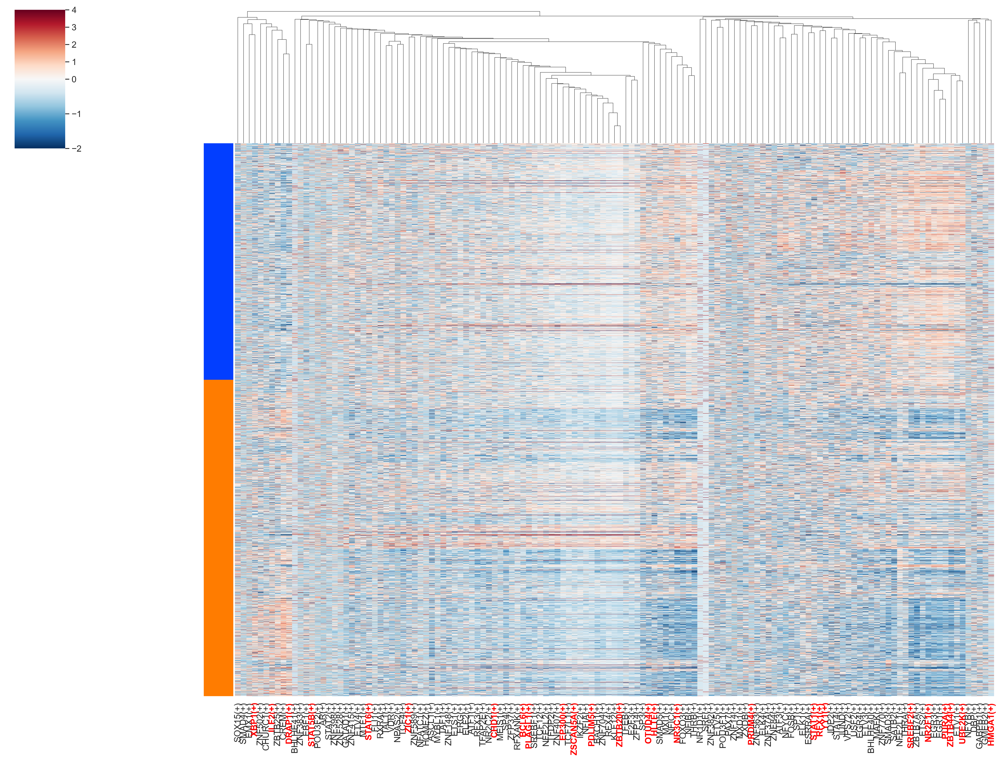

In [76]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# Custom diverging normalization
div_norm = mcolors.TwoSlopeNorm(vmin=-2, vcenter=0, vmax=4)

# Sort rows (cells) by condition
sorted_cells = cellAnnot.loc[auc_mtx_Z_sig.index].sort_values("Condition").index
auc_sorted = auc_mtx_Z_sig.loc[sorted_cells]

# Align row_colors with sorted cells
row_colors_sorted = [colormap[auc_mtx_Z_sig.index.get_loc(cell)] for cell in sorted_cells]

# Plot clustermap
sns.set(font_scale=1.2)
g = sns.clustermap(
    auc_sorted,
    annot=False,
    square=False,
    linecolor='gray',
    yticklabels=False,
    xticklabels=True,
    norm=div_norm,
    row_colors=row_colors_sorted,
    cmap="RdBu_r",
    figsize=(21, 16),
    row_cluster=False  # Maintain grouping by condition
)

# Highlight RBP regulons in red
for label in g.ax_heatmap.get_xticklabels():
    if label.get_text() in regulon_list:
        label.set_color("red")
        label.set_fontweight("bold")

# Final formatting
g.cax.set_visible(True)
g.ax_heatmap.set_ylabel('')
g.ax_heatmap.set_xlabel('')

# Save
plt.savefig("Results/NEN_I/NEN_I_regulon-heatmap-highlighted-diverging-ordered_by_condition.png", dpi=300, bbox_inches="tight")

/opt/anaconda3/envs/scenic_env_py310/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


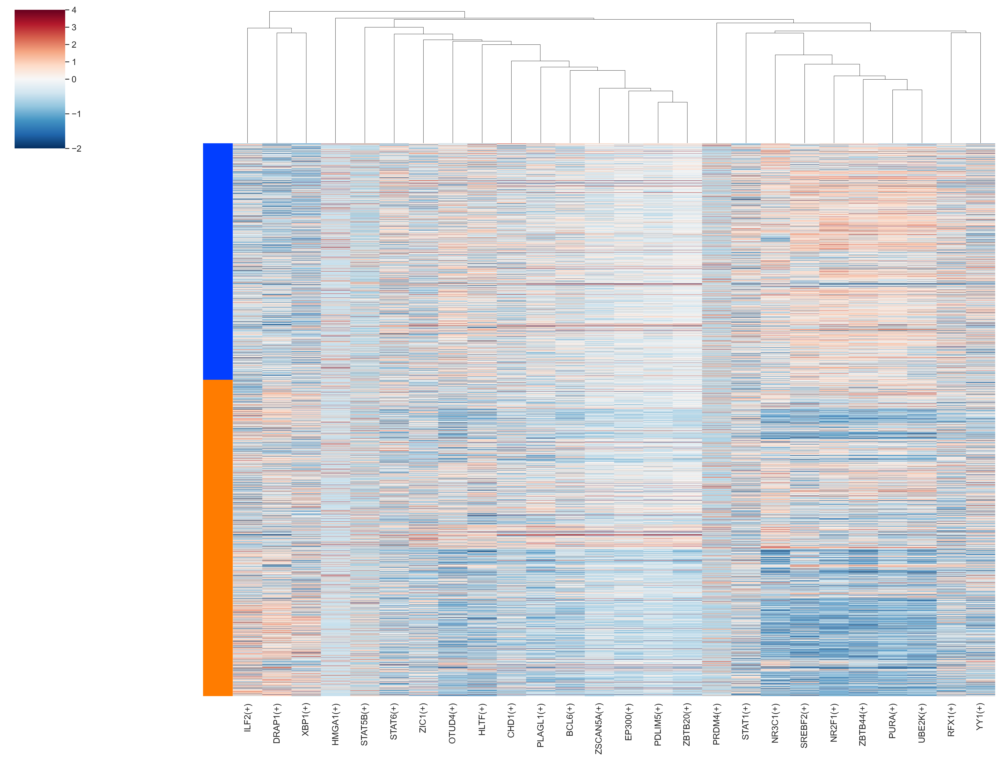

In [77]:
# Step 2: Filter AUC matrix
auc_subset2 = auc_mtx_Z_sig.loc[:, auc_mtx_Z_sig.columns.intersection(regulon_list)]

# Step 3: Sort rows (cells) by condition
sorted_cells = cellAnnot.loc[auc_subset2.index].sort_values("Condition").index
auc_subset2_sorted = auc_subset2.loc[sorted_cells]

# Step 4: Align row_colors to sorted cells
row_colors_sorted = [colormap[auc_subset2.index.get_loc(cell)] for cell in sorted_cells]

# Step 5: Set diverging normalization from -2 (min) to 4 (max), center at 0
div_norm = mcolors.TwoSlopeNorm(vmin=-2, vcenter=0, vmax=4)

# Step 6: Plot clustermap
sns.set(font_scale=1.2)
g = sns.clustermap(
    auc_subset2_sorted,
    annot=False,
    square=False,
    linecolor='gray',
    yticklabels=False,
    xticklabels=True,
    row_colors=row_colors_sorted,
    cmap="RdBu_r",
    norm=div_norm,
    figsize=(21, 16),
    row_cluster=False
)

# Final polish
g.cax.set_visible(True)
g.ax_heatmap.set_ylabel('')
g.ax_heatmap.set_xlabel('')

# Save figure
plt.savefig("Results/NEN_I/NEN_I_regulon-heatmap-RBPs-trimmed.png", dpi=300, bbox_inches="tight")

/opt/anaconda3/envs/scenic_env_py310/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


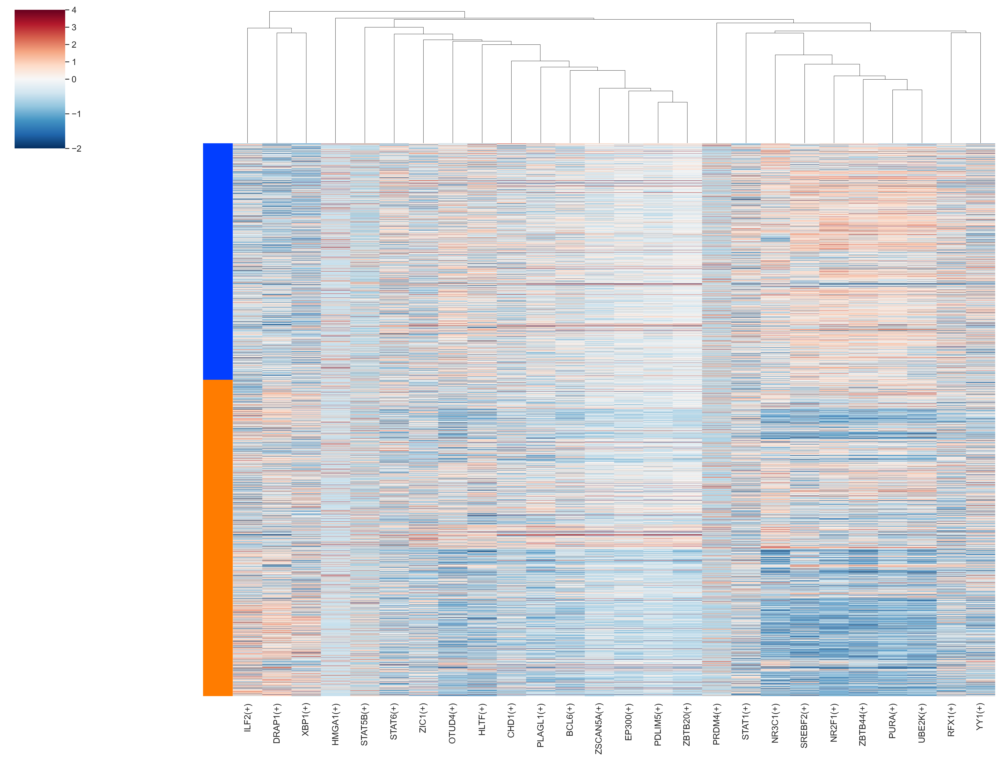

In [78]:
# Step 2: Filter AUC matrix
auc_subset2 = auc_mtx_Z_sig.loc[:, auc_mtx_Z_sig.columns.intersection(regulon_list)]

# Step 3: Sort rows (cells) by condition
sorted_cells = cellAnnot.loc[auc_subset2.index].sort_values("Condition").index
auc_subset2_sorted = auc_subset2.loc[sorted_cells]

# Step 4: Align row_colors to sorted cells
row_colors_sorted = [colormap[auc_subset2.index.get_loc(cell)] for cell in sorted_cells]

# Step 5: Set diverging normalization from -2 (min) to 4 (max), center at 0
div_norm = mcolors.TwoSlopeNorm(vmin=-2, vcenter=0, vmax=4)

# Step 6: Plot clustermap
sns.set(font_scale=1.2)
g = sns.clustermap(
    auc_subset2_sorted,
    annot=False,
    square=False,
    linecolor='gray',
    yticklabels=False,
    xticklabels=True,
    row_colors=row_colors_sorted,
    cmap="RdBu_r",
    norm=div_norm,
    figsize=(21, 16),
    row_cluster=False
)

# Final polish
g.cax.set_visible(True)
g.ax_heatmap.set_ylabel('')
g.ax_heatmap.set_xlabel('')

# Save figure
plt.savefig("Results/NEN_I/NEN_I_regulon-heatmap-RBPs-trimmed.png", dpi=300, bbox_inches="tight")